In [9]:
import math
import numpy as np
import pandas as pd
import plotly.express as px
from keras.models import load_model
import matplotlib.pyplot as plt
# MacOS matplotlib kernel issue
import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'

Using TensorFlow backend.
/Users/tejas/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning:

Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.

/Users/tejas/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning:

Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.

/Users/tejas/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning:

Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.

/Users/tejas/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning:

Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of nu

In [10]:
generator_model = load_model('./GANModels11k/GENmodel_11800.h5')

/Users/tejas/anaconda3/lib/python3.7/site-packages/keras/engine/saving.py:292: UserWarning:

No training configuration found in save file: the model was *not* compiled. Compile it manually.



In [13]:
def save_fig(predicted):
    # Only 32 images will be printed
    BATCH_SIZE = created_faces.shape[0]
    if BATCH_SIZE > 32:
        predicted = predicted[:32]
    num_images = predicted.shape[0]
    fig = plt.figure(figsize=(15,7))
    columns = 8
    rows = np.ceil(num_images / columns)
    for i in range(num_images):
        fig.add_subplot(rows, columns, i+1)
        my_image = predicted[i]
        # Denormalize Image
        my_image = ((my_image + 1) * 127.5) / 255
#         my_image = (predicted[i] * 255).astype(np.uint8) / 255
        plt.imshow(my_image)
#     plt.savefig('./GeneratedFigures/image_'+current_time+'.jpg', bbox_inches = 'tight', pad_inches = 0.1)
    plt.show(block=True)

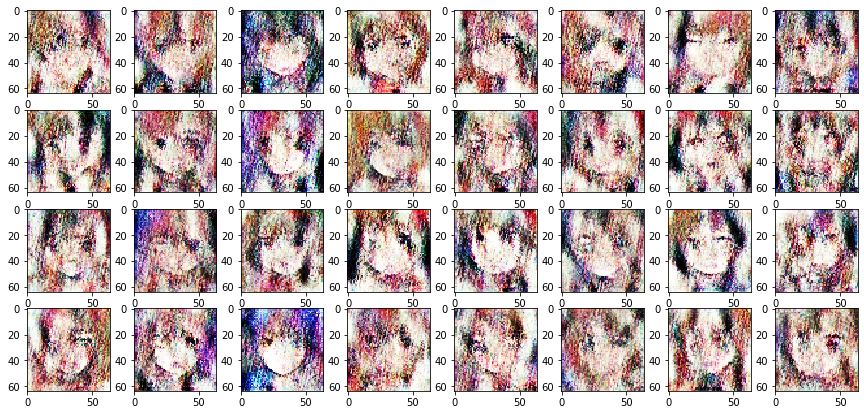

In [14]:
gen_shape = tuple(generator_model.input.get_shape().as_list()[1:])
gen_noise = np.random.normal(loc=0, scale=1, size=(32,)+gen_shape)
created_faces = generator_model.predict(gen_noise)
save_fig(created_faces)

In [2]:
df = pd.read_csv('log11k.csv')
df

,Step,RealDiscLoss,RealDiscAcc,GenDiscLoss,GenDiscAcc,GANLoss,GANAcc
0,1,0.662953,0.625000,0.850073,0.000000,0.782585,0.000000
1,2,0.005983,1.000000,7.226605,0.000000,3.708942,0.000000
2,3,1.463952,0.562500,0.664093,1.000000,0.813095,0.000000
3,4,0.006673,1.000000,0.920033,0.000000,0.826944,0.015625
4,5,0.010945,1.000000,1.411432,0.000000,1.925935,0.000000
...,...,...,...,...,...,...,...
11801,11802,0.848290,0.187500,0.793728,0.265625,0.836454,0.140625
11802,11803,0.822758,0.140625,0.792415,0.250000,0.765773,0.265625
11803,11804,0.792826,0.125000,0.779407,0.250000,0.805161,0.140625
11804,11805,0.804881,0.187500,0.807500,0.140625,0.805715,0.218750


In [3]:
real_disc_df = df[['Step', 'RealDiscLoss', 'RealDiscAcc']]
real_disc_df = real_disc_df.rename(columns={'RealDiscLoss': 'Loss', 'RealDiscAcc': 'Accuracy'})
real_disc_df['Name'] = 'Real Discriminator'

gen_disc_df = df[['Step', 'GenDiscLoss', 'GenDiscAcc']]
gen_disc_df = gen_disc_df.rename(columns={'GenDiscLoss': 'Loss', 'GenDiscAcc': 'Accuracy'})
gen_disc_df['Name'] = 'Fake Discriminator'

gan_df = df[['Step', 'GANLoss', 'GANAcc']]
gan_df = gan_df.rename(columns={'GANLoss': 'Loss', 'GANAcc': 'Accuracy'})
gan_df['Name'] = 'GAN'

combined_df = pd.concat([real_disc_df, gen_disc_df, gan_df])

In [4]:
fig = px.line(combined_df, x='Step', y='Loss', color='Name', line_group='Name', title='Plot of Discriminator and GAN Losses')
fig.show()

In [5]:
fig = px.line(combined_df, x='Step', y='Accuracy', color='Name', line_group='Name', title='Plot of Discriminator and GAN Accuracies')
fig.show()

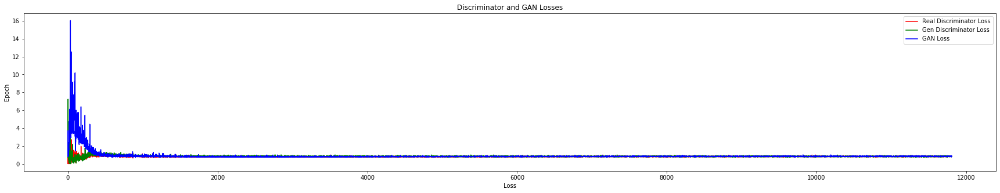

In [6]:
plt.figure(figsize=(30,5))
plt.plot(df['Step'],df['RealDiscLoss'],'b',label='Real Discriminator Loss', c='red')
plt.plot(df['Step'],df['GenDiscLoss'],'b',label='Gen Discriminator Loss', c='green')
plt.plot(df['Step'],df['GANLoss'],'b',label='GAN Loss', c='blue')
plt.title('Discriminator and GAN Losses')
plt.ylabel('Epoch')
plt.xlabel('Loss')
plt.legend(loc='best')
plt.show()

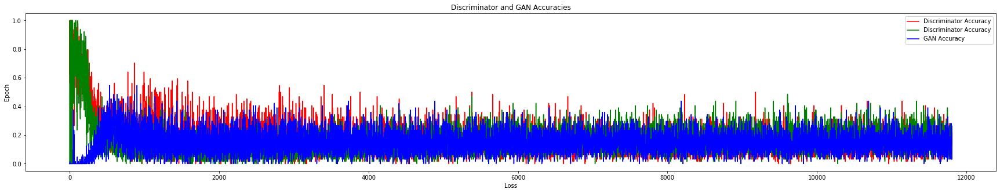

In [7]:
plt.figure(figsize=(30,5))
plt.plot(df['Step'],df['RealDiscAcc'],'b',label='Discriminator Accuracy', c='red')
plt.plot(df['Step'],df['GenDiscAcc'],'b',label='Discriminator Accuracy', c='green')
plt.plot(df['Step'],df['GANAcc'],'b',label='GAN Accuracy', c='blue')
plt.title('Discriminator and GAN Accuracies')
plt.ylabel('Epoch')
plt.xlabel('Loss')
plt.legend(loc='best')
plt.show()

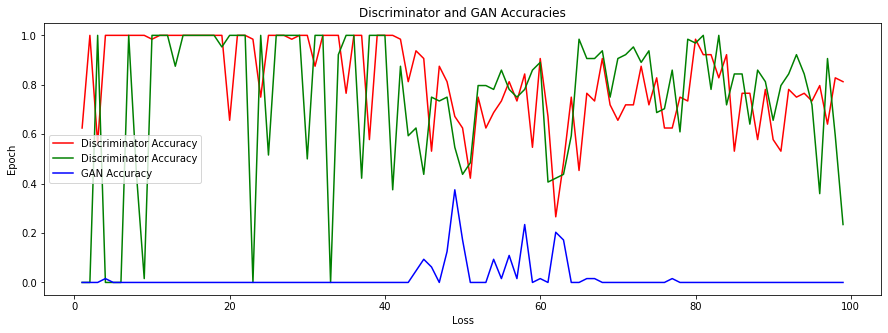

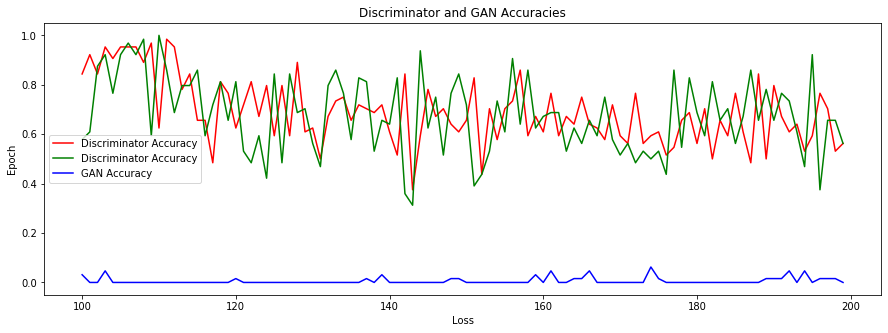

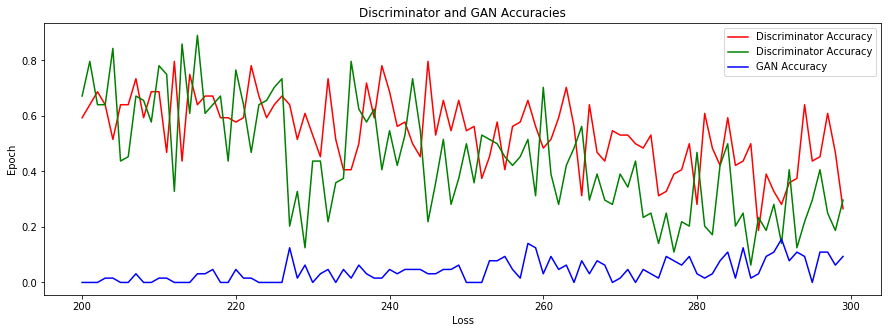

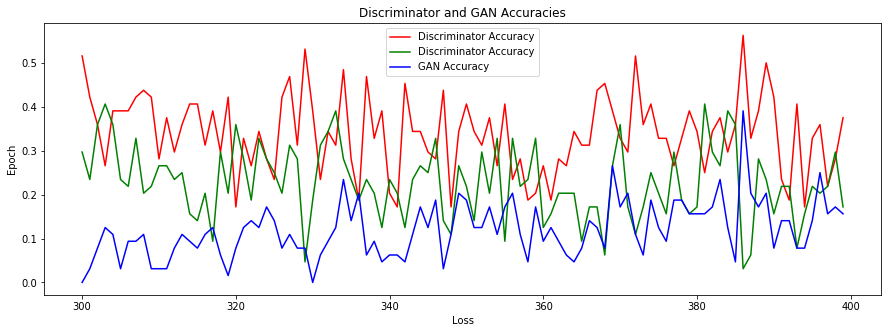

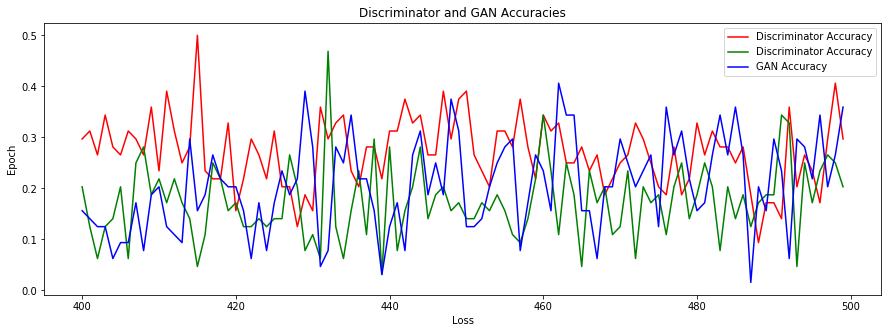

...

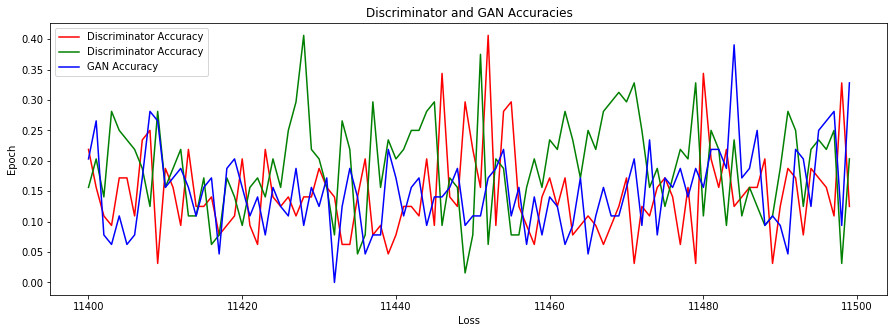

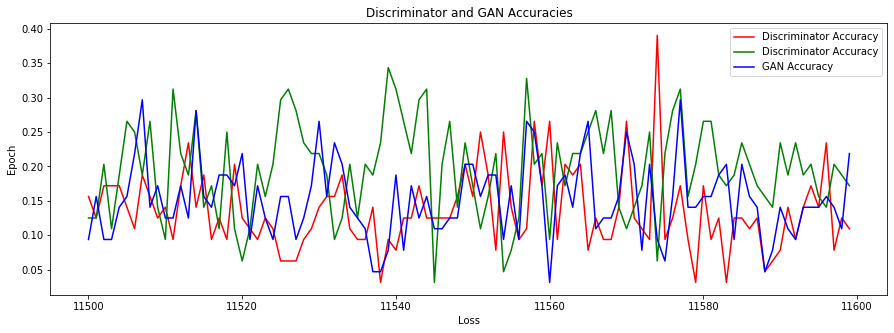

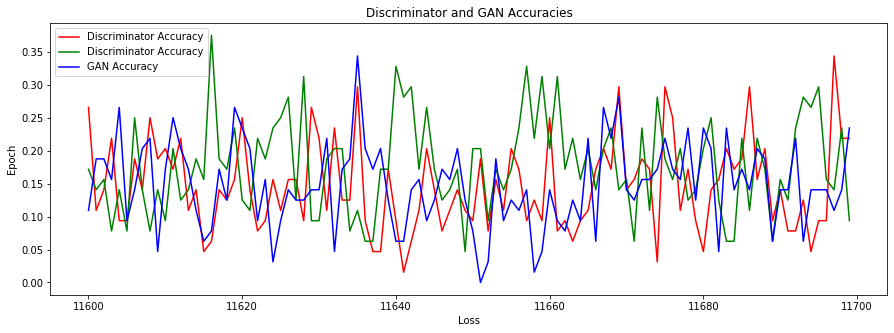

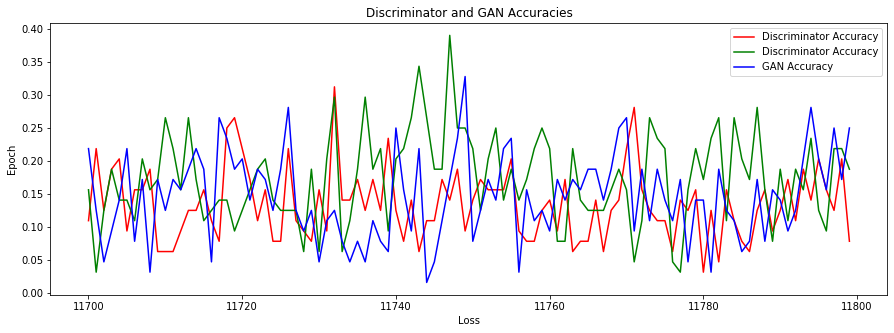

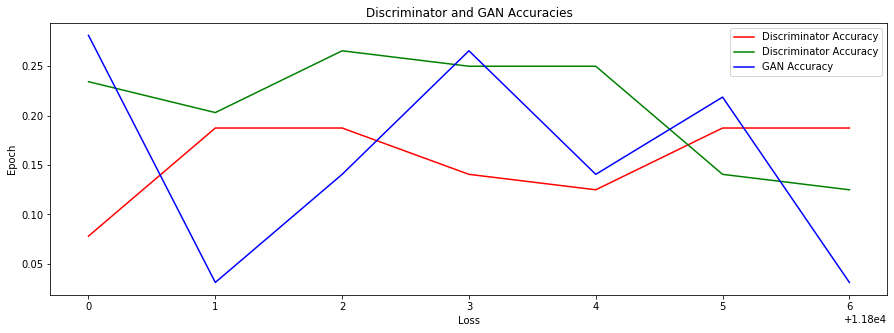

In [8]:
rounded = int(math.ceil(len(df) / 100.0)) * 100
ranges = np.arange(0, (rounded + 100), 100)
for i in range(len(ranges[:-1])):
    df_slice = df.loc[(df['Step'] >= ranges[i]) & (df['Step'] <ranges[i+1])]
    plt.figure(figsize=(15,5))
    plt.plot(df_slice['Step'],df_slice['RealDiscAcc'],'b',label='Discriminator Accuracy', c='red')
    plt.plot(df_slice['Step'],df_slice['GenDiscAcc'],'b',label='Discriminator Accuracy', c='green')
    plt.plot(df_slice['Step'],df_slice['GANAcc'],'b',label='GAN Accuracy', c='blue')
    plt.title('Discriminator and GAN Accuracies')
    plt.ylabel('Epoch')
    plt.xlabel('Loss')
    plt.legend(loc='best')
    plt.show()